In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [2]:
# Membaca data Image
images = [
    "../img/kucing.jpg",
    "../img/gradient.png",
    "../img/Penguins.jpg",
    "../img/arizona.jpg",
    "../img/Tulips.jpg",
    "../img/Koala.jpg",
]

# Set up the subplot grid
rows = len(images)
cols = 4

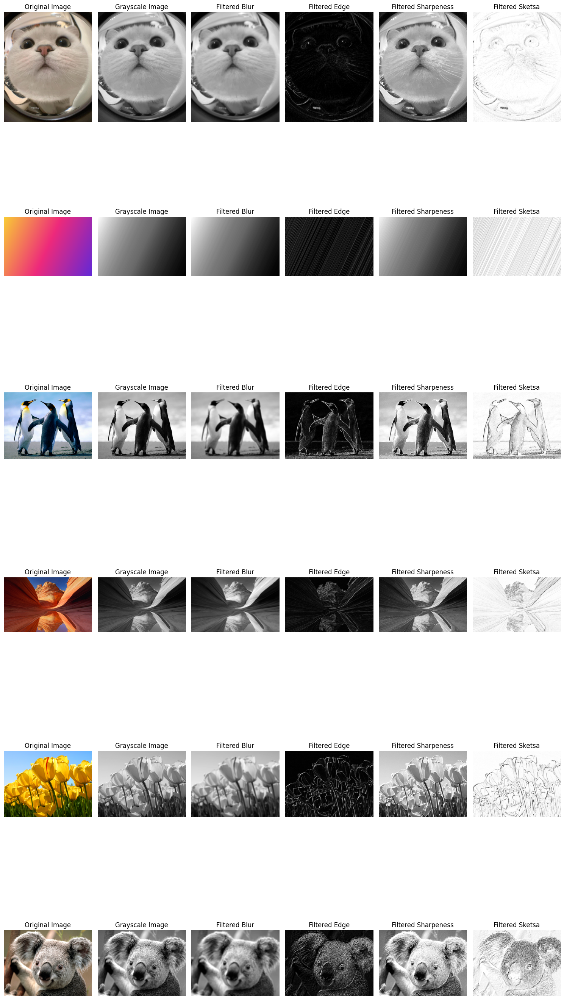

In [3]:
# ==============================
# Filtering Convolusi dengan Beberapa Kernel
# ==============================
# Create a subplot for each image
fig, axes = plt.subplots(rows, 6, figsize=(15, 5 * rows))

# Loop through each image
for i, imgFilename in enumerate(images):
    # Membaca data Image
    oriImg = cv2.imread(imgFilename)

    # Display the original image
    axes[i, 0].imshow(cv2.cvtColor(oriImg, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis("off")

    # Membaca data Image
    img = cv2.imread(imgFilename, 0)

    kernel = np.ones((15, 15), np.float32) / 225
    dst_blur = cv2.filter2D(img, -1, kernel)
    kernel_v = np.array([[1, 0, -1], [2, 0, -2], [1, 0, -1]])
    kernel_h = np.transpose(kernel_v)
    dst_h = cv2.filter2D(img, -1, kernel_h)
    dst_v = cv2.filter2D(img, -1, kernel_v)
    dst_edge = cv2.add(dst_v, dst_h)
    img2 = cv2.add(img, dst_edge)
    img_inverse = 255 - dst_edge

    titles = [
        "Grayscale Image",
        "Filtered Blur",
        "Filtered Edge",
        "Filtered Sharpeness",
        "Filtered Sketsa",
    ]

    brightnesImg = [img, dst_blur, dst_edge, img2, img_inverse]

    for j in range(len(titles)):
        # Display the image
        axes[i, j + 1].imshow(brightnesImg[j], cmap="gray")
        axes[i, j + 1].set_title(f"{titles[j]}")
        axes[i, j + 1].axis("off")

# Show the plot
plt.tight_layout()
plt.show()

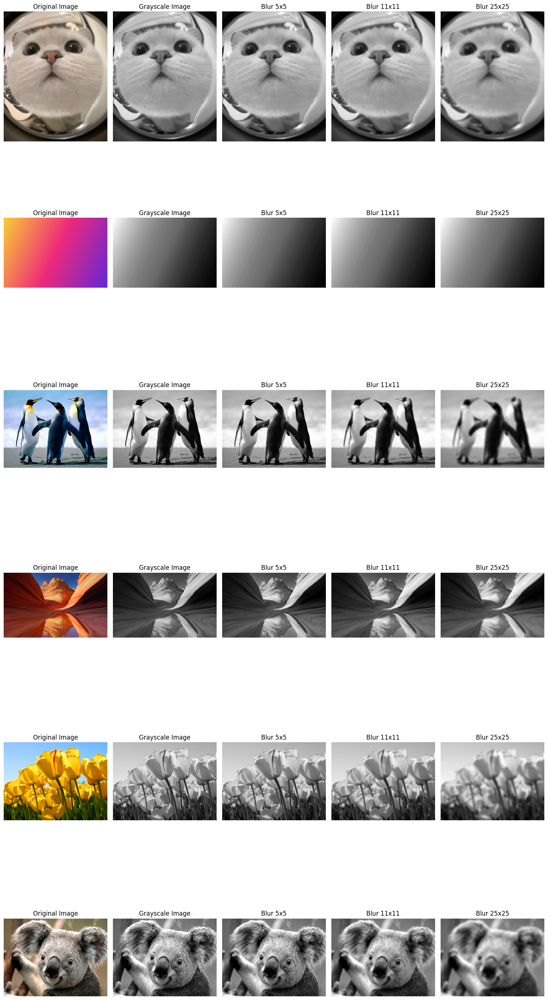

In [4]:
# ==============================
# Filter Blur dengan Berbagai Ukuran Mask
# ==============================
# Create a subplot for each image
fig, axes = plt.subplots(rows, 5, figsize=(15, 5 * rows))

# Loop through each image
for i, imgFilename in enumerate(images):
    # Membaca data Image
    oriImg = cv2.imread(imgFilename)

    # Display the original image
    axes[i, 0].imshow(cv2.cvtColor(oriImg, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis("off")

    # Membaca data Image
    img = cv2.imread(imgFilename, 0)

    img_blur1 = cv2.blur(img, [5, 5])
    img_blur2 = cv2.blur(img, [11, 11])
    img_blur3 = cv2.blur(img, [25, 25])

    titles = [
        "Grayscale Image",
        "Blur 5x5",
        "Blur 11x11",
        "Blur 25x25",
    ]

    brightnesImg = [img, img_blur1, img_blur2, img_blur3]

    for j in range(len(titles)):
        # Display the image
        axes[i, j + 1].imshow(brightnesImg[j], cmap="gray")
        axes[i, j + 1].set_title(f"{titles[j]}")
        axes[i, j + 1].axis("off")

# Show the plot
plt.tight_layout()
plt.show()

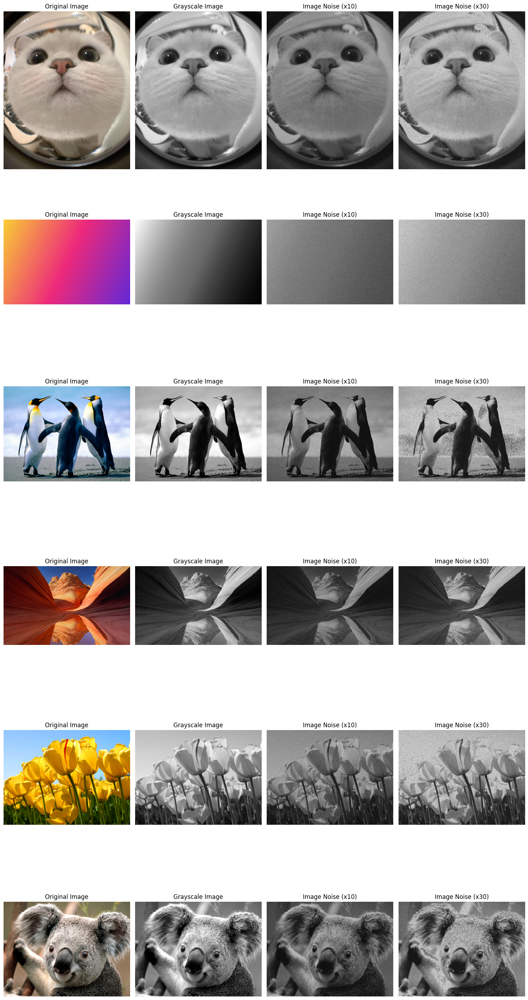

In [5]:
# ==============================
# Citra + Noise
# ==============================
# Create a subplot for each image
fig, axes = plt.subplots(rows, cols, figsize=(15, 5 * rows))

# Loop through each image
for i, imgFilename in enumerate(images):
    # Membaca data Image
    oriImg = cv2.imread(imgFilename)

    # Display the original image
    axes[i, 0].imshow(cv2.cvtColor(oriImg, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis("off")

    # Membaca data Image
    img = cv2.imread(imgFilename, 0)

    noise = np.random.randn(*img.shape) * 10
    img_noise = np.abs(img + noise)
    img_noise = np.uint8(img_noise)
    noise = np.random.randn(*img.shape) * 30
    img_noise = np.abs(img + noise)
    img_noise_2 = np.uint8(img_noise)

    titles = [
        "Grayscale Image",
        "Image Noise (x10)",
        "Image Noise (x30)",
    ]

    brightnesImg = [img, img_noise, img_noise_2]

    for j in range(len(titles)):
        # Display the image
        axes[i, j + 1].imshow(brightnesImg[j], cmap="gray")
        axes[i, j + 1].set_title(f"{titles[j]}")
        axes[i, j + 1].axis("off")

# Show the plot
plt.tight_layout()
plt.show()

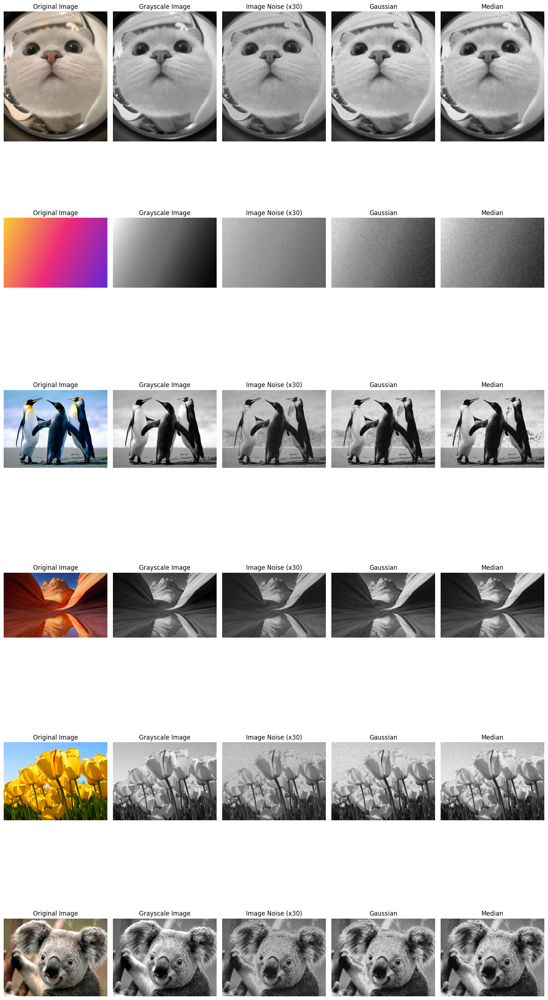

In [6]:
# ==============================
# Reduksi Noise Grausian dan Median Filter
# ==============================
# Create a subplot for each image
fig, axes = plt.subplots(rows, 5, figsize=(15, 5 * rows))

# Loop through each image
for i, imgFilename in enumerate(images):
    # Membaca data Image
    oriImg = cv2.imread(imgFilename)

    # Display the original image
    axes[i, 0].imshow(cv2.cvtColor(oriImg, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis("off")

    # Membaca data Image
    img = cv2.imread(imgFilename, 0)

    noise = np.random.randn(*img.shape) * 30
    img_noise = np.abs(img + noise)
    img_noise = np.uint8(img_noise)
    dst_gauss = cv2.GaussianBlur(img_noise, [7, 7], 0)
    dst_med = cv2.medianBlur(img_noise, 7)

    titles = [
        "Grayscale Image",
        "Image Noise (x30)",
        "Gaussian",
        "Median",
    ]

    brightnesImg = [img, img_noise, dst_gauss, dst_med]

    for j in range(len(titles)):
        # Display the image
        axes[i, j + 1].imshow(brightnesImg[j], cmap="gray")
        axes[i, j + 1].set_title(f"{titles[j]}")
        axes[i, j + 1].axis("off")

# Show the plot
plt.tight_layout()
plt.show()

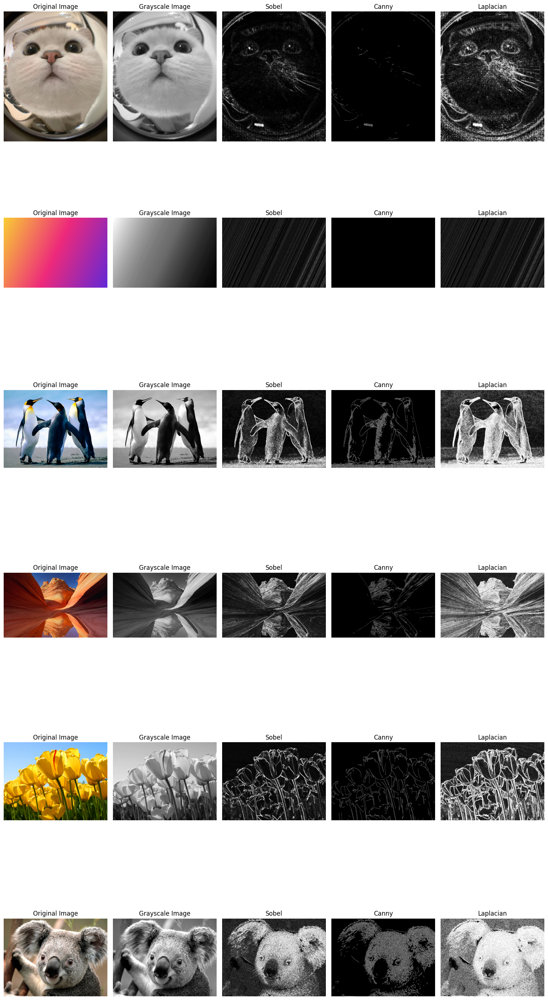

In [7]:
# ==============================
# Deteksi Tepi Sobel, Canny dan Laplacian Filter
# ==============================
# Create a subplot for each image
fig, axes = plt.subplots(rows, 5, figsize=(15, 5 * rows))

# Loop through each image
for i, imgFilename in enumerate(images):
    # Membaca data Image
    oriImg = cv2.imread(imgFilename)

    # Display the original image
    axes[i, 0].imshow(cv2.cvtColor(oriImg, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis("off")

    # Membaca data Image
    img = cv2.imread(imgFilename, 0)

    sobel_x = cv2.Sobel(src=img, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=5)
    sobel_y = cv2.Sobel(src=img, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=5)
    sobel = cv2.Sobel(src=img, ddepth=cv2.CV_64F, dx=1, dy=1, ksize=5)
    sobel = cv2.convertScaleAbs(sobel)

    canny = cv2.Canny(img, 100, 200)
    im_lap = cv2.Laplacian(img, ksize=5, ddepth=cv2.CV_64F)
    im_lap = cv2.convertScaleAbs(im_lap)

    titles = [
        "Grayscale Image",
        "Sobel",
        "Canny",
        "Laplacian",
    ]

    brightnesImg = [img, sobel, canny, im_lap]

    for j in range(len(titles)):
        # Display the image
        axes[i, j + 1].imshow(brightnesImg[j], cmap="gray")
        axes[i, j + 1].set_title(f"{titles[j]}")
        axes[i, j + 1].axis("off")

# Show the plot
plt.tight_layout()
plt.show()

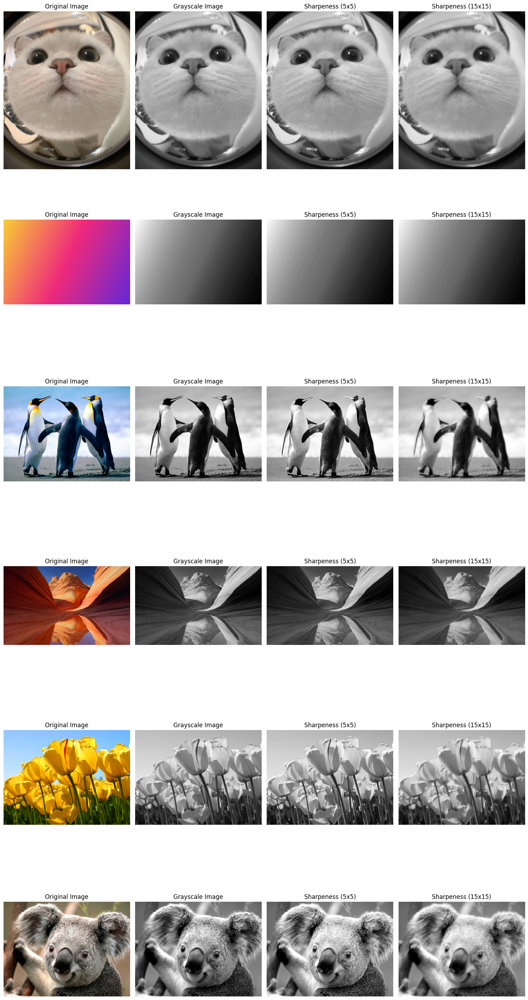

In [8]:
# ==============================
# Sharpeness
# ==============================
# Create a subplot for each image
fig, axes = plt.subplots(rows, cols, figsize=(15, 5 * rows))

# Loop through each image
for i, imgFilename in enumerate(images):
    # Membaca data Image
    oriImg = cv2.imread(imgFilename)

    # Display the original image
    axes[i, 0].imshow(cv2.cvtColor(oriImg, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis("off")

    # Membaca data Image
    img = cv2.imread(imgFilename, 0)

    kernel1 = np.ones([5, 5], np.float32) / 25
    img_blur = cv2.filter2D(img, -1, kernel1)
    kernel2a = np.array([[1, 0, -1], [2, 0, -2], [1, 0, -1]])
    kernel2b = np.transpose(kernel2a)
    kernel2 = kernel2a + kernel2b
    img_edge = 0.5 * cv2.filter2D(img, -1, kernel2)
    img_edge = np.uint8(img_edge)
    img_sharp = cv2.add(img_blur, img_edge)

    kernel1 = np.ones([15, 15], np.float32) / 225
    img_blur = cv2.filter2D(img, -1, kernel1)
    kernel2a = np.array([[1, 0, -1], [2, 0, -2], [1, 0, -1]])
    kernel2b = np.transpose(kernel2a)
    kernel2 = kernel2a + kernel2b
    img_edge = 0.5 * cv2.filter2D(img, -1, kernel2)
    img_edge = np.uint8(img_edge)
    img_sharp2 = cv2.add(img_blur, img_edge)

    titles = [
        "Grayscale Image",
        "Sharpeness (5x5)",
        "Sharpeness (15x15)",
    ]

    brightnesImg = [img, img_sharp, img_sharp2]

    for j in range(len(titles)):
        # Display the image
        axes[i, j + 1].imshow(brightnesImg[j], cmap="gray")
        axes[i, j + 1].set_title(f"{titles[j]}")
        axes[i, j + 1].axis("off")

# Show the plot
plt.tight_layout()
plt.show()

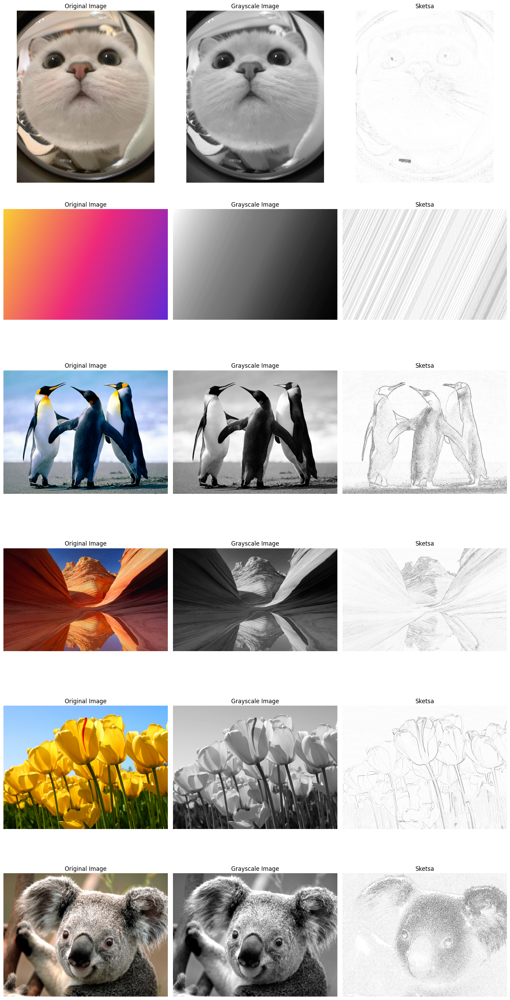

In [9]:
# ==============================
# Citra Sketsa
# ==============================
# Create a subplot for each image
fig, axes = plt.subplots(rows, 3, figsize=(15, 5 * rows))

# Loop through each image
for i, imgFilename in enumerate(images):
    # Membaca data Image
    oriImg = cv2.imread(imgFilename)

    # Display the original image
    axes[i, 0].imshow(cv2.cvtColor(oriImg, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis("off")

    # Membaca data Image
    img = cv2.imread(imgFilename, 0)

    kernel = np.array([[1, 2, 1], [2, -12, 2], [1, 2, 1]])
    dst = cv2.filter2D(img, -1, kernel)
    sketsa = 255 - dst

    titles = [
        "Grayscale Image",
        "Sketsa",
    ]

    brightnesImg = [img, sketsa]

    for j in range(len(titles)):
        # Display the image
        axes[i, j + 1].imshow(brightnesImg[j], cmap="gray")
        axes[i, j + 1].set_title(f"{titles[j]}")
        axes[i, j + 1].axis("off")

# Show the plot
plt.tight_layout()
plt.show()

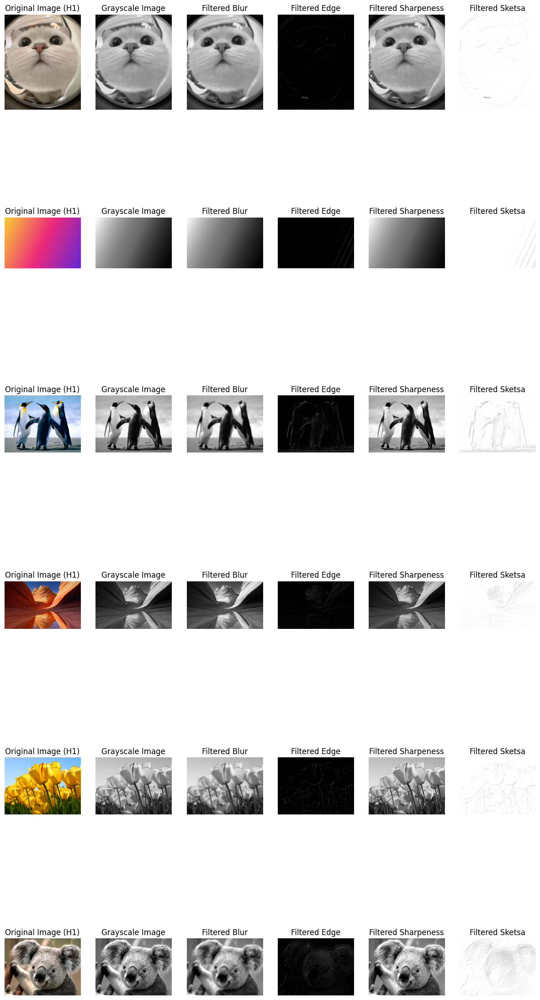

In [10]:
# ==============================
# Nomor 2 (H1)
# ==============================
# Create a subplot for each image
fig, axes = plt.subplots(rows, 6, figsize=(15, 5 * rows))

# Loop through each image
for i, imgFilename in enumerate(images):
    # Membaca data Image
    oriImg = cv2.imread(imgFilename)

    # Display the original image
    axes[i, 0].imshow(cv2.cvtColor(oriImg, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Original Image (H1)")
    axes[i, 0].axis("off")

    # Membaca data Image
    img = cv2.imread(imgFilename, 0)

    kernel_h21 = np.ones((15, 15), np.float32) / 225
    dst_blur_h21 = cv2.filter2D(img, -1, kernel_h21)
    kernel_v_h21 = np.array(
        [
            [0, -0.5, 0],
            [-0.5, 0, 0.5],
            [0, 0.5, 0],
        ]
    )
    kernel_h_h21 = np.transpose(kernel_v_h21)
    dst_h_h21 = cv2.filter2D(img, -1, kernel_h_h21)
    dst_v_h21 = cv2.filter2D(img, -1, kernel_v_h21)
    dst_edge_h21 = cv2.add(dst_v_h21, dst_h_h21)
    img2_h21 = cv2.add(img, dst_edge_h21)
    img_inverse_h21 = 255 - dst_edge_h21

    titles = [
        "Grayscale Image",
        "Filtered Blur",
        "Filtered Edge",
        "Filtered Sharpeness",
        "Filtered Sketsa",
    ]

    brightnesImg = [img, dst_blur_h21, dst_edge_h21, img2_h21, img_inverse_h21]

    for j in range(len(titles)):
        # Display the image
        axes[i, j + 1].imshow(brightnesImg[j], cmap="gray")
        axes[i, j + 1].set_title(f"{titles[j]}")
        axes[i, j + 1].axis("off")

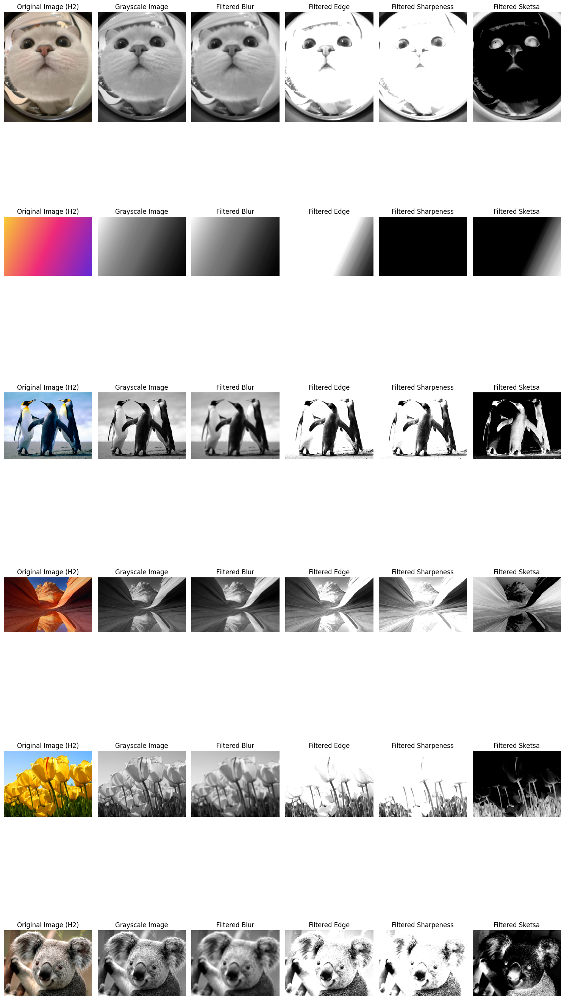

In [11]:
# Nomor 2 (H2)
# Create a subplot for each image
fig, axes = plt.subplots(rows, 6, figsize=(15, 5 * rows))

# Loop through each image
for i, imgFilename in enumerate(images):
    # Membaca data Image
    oriImg = cv2.imread(imgFilename)

    # Display the original image
    axes[i, 0].imshow(cv2.cvtColor(oriImg, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Original Image (H2)")
    axes[i, 0].axis("off")

    # Membaca data Image
    img = cv2.imread(imgFilename, 0)

    kernel_h22 = np.ones((15, 15), np.float32) / 225
    dst_blur_h22 = cv2.filter2D(img, -1, kernel_h22)
    kernel_v_h22 = np.array(
        [
            [0, -0.5, 0],
            [-0.5, 1, 0.5],
            [0, 0.5, 0],
        ]
    )
    kernel_h_h22 = np.transpose(kernel_v_h22)
    dst_h_h22 = cv2.filter2D(img, -1, kernel_h_h22)
    dst_v_h22 = cv2.filter2D(img, -1, kernel_v_h22)
    dst_edge_h22 = cv2.add(dst_v_h22, dst_h_h22)
    img2_h22 = cv2.add(img, dst_edge_h22)
    img_inverse_h22 = 255 - dst_edge_h22

    titles = [
        "Grayscale Image",
        "Filtered Blur",
        "Filtered Edge",
        "Filtered Sharpeness",
        "Filtered Sketsa",
    ]

    brightnesImg = [img, dst_blur_h22, dst_edge_h22, img2_h22, img_inverse_h22]

    for j in range(len(titles)):
        # Display the image
        axes[i, j + 1].imshow(brightnesImg[j], cmap="gray")
        axes[i, j + 1].set_title(f"{titles[j]}")
        axes[i, j + 1].axis("off")

# Show the plot
plt.tight_layout()
plt.show()

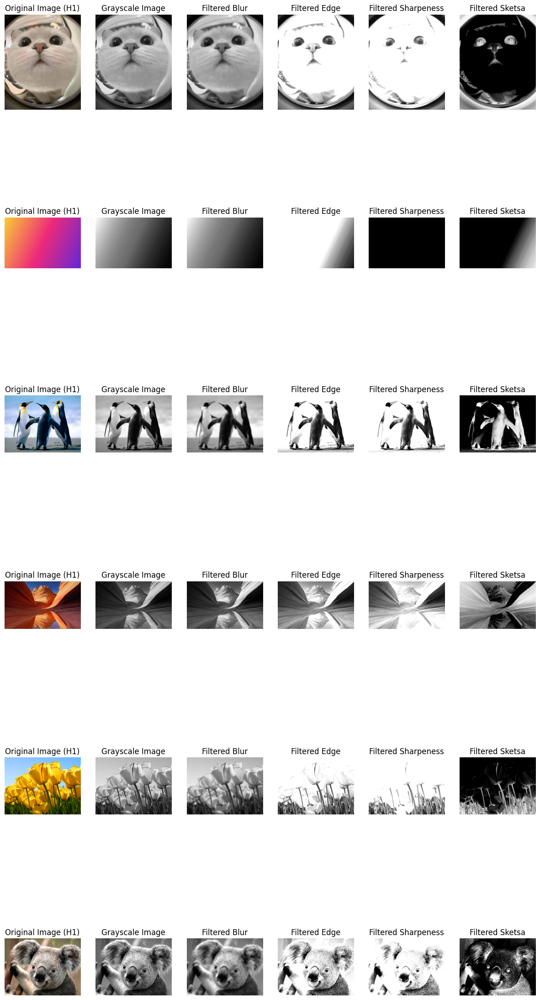

In [13]:
# ==============================
# Nomor 3 (H1)
# ==============================
# Create a subplot for each image
fig, axes = plt.subplots(rows, 6, figsize=(15, 5 * rows))

# Loop through each image
for i, imgFilename in enumerate(images):
    # Membaca data Image
    oriImg = cv2.imread(imgFilename)

    # Display the original image
    axes[i, 0].imshow(cv2.cvtColor(oriImg, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Original Image (H1)")
    axes[i, 0].axis("off")

    # Membaca data Image
    img = cv2.imread(imgFilename, 0)

    kernel_h31 = np.ones((15, 15), np.float32) / 225
    dst_blur_h31 = cv2.filter2D(img, -1, kernel_h31)
    kernel_v_h31 = np.array(
        [
            [-1, -0.5, 0],
            [-0.5, 1, 0.5],
            [0, 0.5, 1],
        ]
    )
    kernel_h_h31 = np.transpose(kernel_v_h31)
    dst_h_h31 = cv2.filter2D(img, -1, kernel_h_h31)
    dst_v_h31 = cv2.filter2D(img, -1, kernel_v_h31)
    dst_edge_h31 = cv2.add(dst_v_h31, dst_h_h31)
    img2_h31 = cv2.add(img, dst_edge_h31)
    img_inverse_h31 = 255 - dst_edge_h31

    titles = [
        "Grayscale Image",
        "Filtered Blur",
        "Filtered Edge",
        "Filtered Sharpeness",
        "Filtered Sketsa",
    ]

    brightnesImg = [img, dst_blur_h31, dst_edge_h31, img2_h31, img_inverse_h31]

    for j in range(len(titles)):
        # Display the image
        axes[i, j + 1].imshow(brightnesImg[j], cmap="gray")
        axes[i, j + 1].set_title(f"{titles[j]}")
        axes[i, j + 1].axis("off")

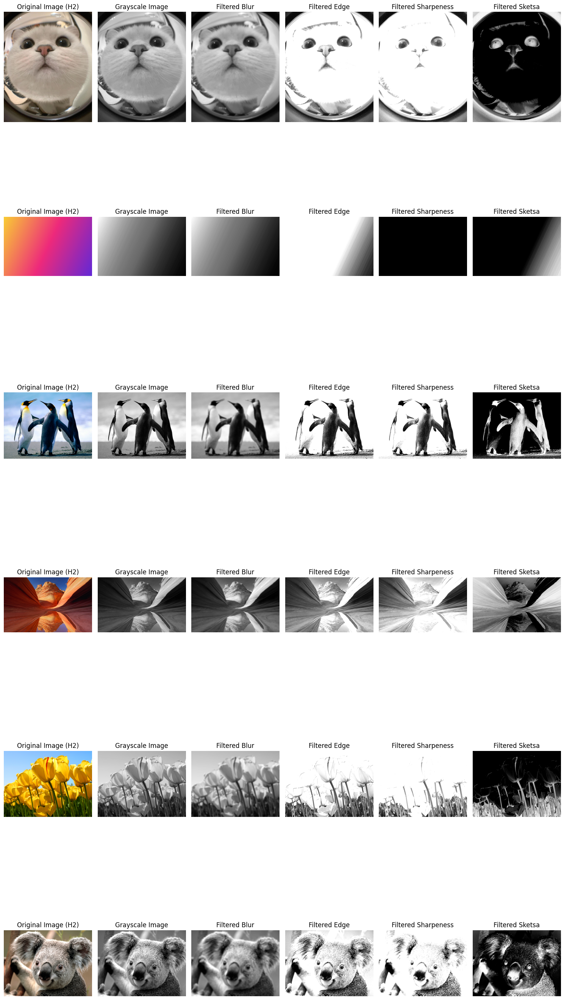

In [14]:
# Nomor 3 (H2)
# Create a subplot for each image
fig, axes = plt.subplots(rows, 6, figsize=(15, 5 * rows))

# Loop through each image
for i, imgFilename in enumerate(images):
    # Membaca data Image
    oriImg = cv2.imread(imgFilename)

    # Display the original image
    axes[i, 0].imshow(cv2.cvtColor(oriImg, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Original Image (H2)")
    axes[i, 0].axis("off")

    # Membaca data Image
    img = cv2.imread(imgFilename, 0)

    kernel_h32 = np.ones((15, 15), np.float32) / 225
    dst_blur_h32 = cv2.filter2D(img, -1, kernel_h32)
    kernel_v_h32 = np.array(
        [
            [-1, -0.5, 0],
            [-0.5, 1, 0.5],
            [0, 0.5, 1],
        ]
    )
    kernel_h_h32 = np.transpose(kernel_v_h32)
    dst_h_h32 = cv2.filter2D(img, -1, kernel_h_h32)
    dst_v_h32 = cv2.filter2D(img, -1, kernel_v_h32)
    dst_edge_h32 = cv2.add(dst_v_h32, dst_h_h32)
    img2_h32 = cv2.add(img, dst_edge_h32)
    img_inverse_h32 = 255 - dst_edge_h32

    titles = [
        "Grayscale Image",
        "Filtered Blur",
        "Filtered Edge",
        "Filtered Sharpeness",
        "Filtered Sketsa",
    ]

    brightnesImg = [img, dst_blur_h32, dst_edge_h32, img2_h32, img_inverse_h32]

    for j in range(len(titles)):
        # Display the image
        axes[i, j + 1].imshow(brightnesImg[j], cmap="gray")
        axes[i, j + 1].set_title(f"{titles[j]}")
        axes[i, j + 1].axis("off")

# Show the plot
plt.tight_layout()
plt.show()

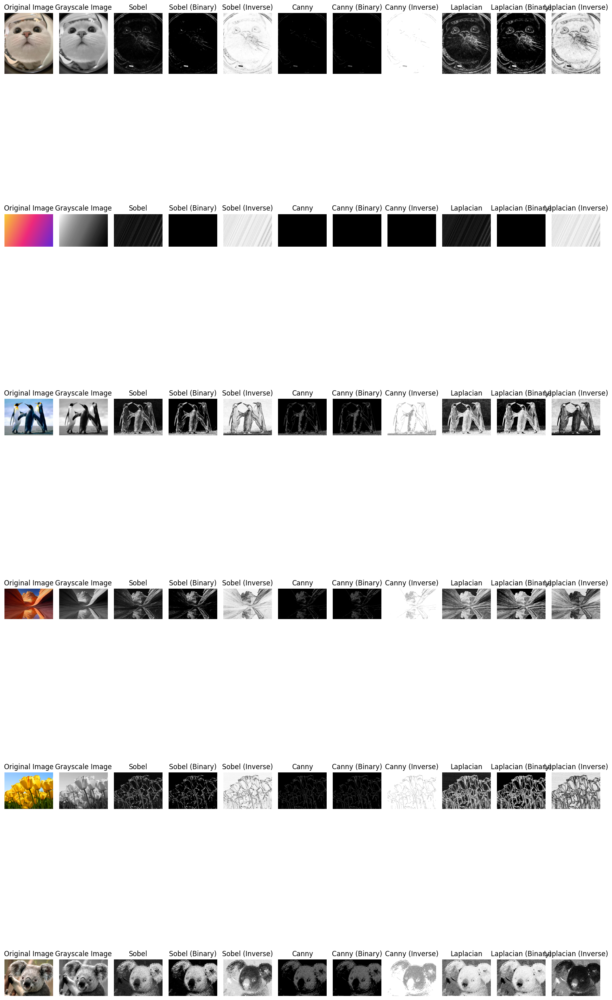

In [15]:
# ==============================
# Nomor 4 dan 5
# ==============================
fig, axes = plt.subplots(rows, 11, figsize=(15, 5 * rows))

# Loop through each image
for i, imgFilename in enumerate(images):
    # Membaca data Image
    oriImg = cv2.imread(imgFilename)

    # Display the original image
    axes[i, 0].imshow(cv2.cvtColor(oriImg, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis("off")

    # Membaca data Image
    img = cv2.imread(imgFilename, 0)

    sobel_x = cv2.Sobel(src=img, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=5)
    sobel_y = cv2.Sobel(src=img, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=5)
    sobel = cv2.Sobel(src=img, ddepth=cv2.CV_64F, dx=1, dy=1, ksize=5)
    sobel = cv2.convertScaleAbs(sobel)
    _, sobel_bin = cv2.threshold(sobel, 128, 255, cv2.THRESH_BINARY)
    sobel_inv = 255 - sobel

    canny = cv2.Canny(img, 100, 200)
    _, canny_bin = cv2.threshold(canny, 128, 255, cv2.THRESH_BINARY)
    canny_inv = 255 - canny

    im_lap = cv2.Laplacian(img, ksize=5, ddepth=cv2.CV_64F)
    im_lap = cv2.convertScaleAbs(im_lap)
    _, im_lap_bin = cv2.threshold(im_lap, 128, 255, cv2.THRESH_BINARY)
    im_lap_inv = 255 - im_lap

    titles = [
        "Grayscale Image",
        "Sobel",
        "Sobel (Binary)",
        "Sobel (Inverse)",
        "Canny",
        "Canny (Binary)",
        "Canny (Inverse)",
        "Laplacian",
        "Laplacian (Binary)",
        "Laplacian (Inverse)",
    ]

    brightnesImg = [
        img,
        sobel,
        sobel_bin,
        sobel_inv,
        canny,
        canny_bin,
        canny_inv,
        im_lap,
        im_lap_bin,
        im_lap_inv,
    ]

    for j in range(len(titles)):
        # Display the image
        axes[i, j + 1].imshow(brightnesImg[j], cmap="gray")
        axes[i, j + 1].set_title(f"{titles[j]}")
        axes[i, j + 1].axis("off")

# Show the plot
plt.tight_layout()
plt.show()

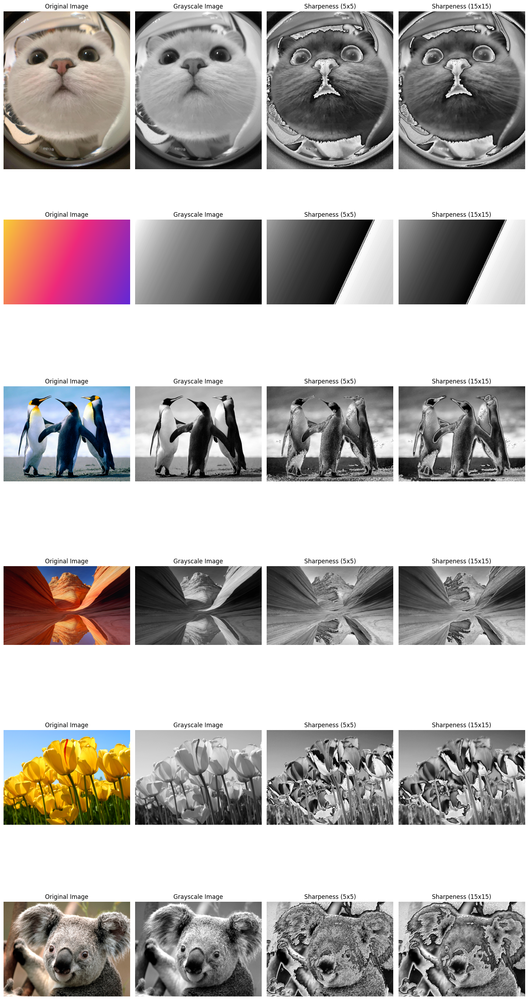

In [16]:
# ==============================
# Nomor 7
# ==============================
# Create a subplot for each image
fig, axes = plt.subplots(rows, cols, figsize=(15, 5 * rows))

# Loop through each image
for i, imgFilename in enumerate(images):
    # Read the image
    oriImg = cv2.imread(imgFilename)

    # Display the original image
    axes[i, 0].imshow(cv2.cvtColor(oriImg, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis("off")

    # Read the image
    img = cv2.imread(imgFilename, 0)

    # Sharpening with 5x5 kernel
    kernel1 = np.ones([5, 5], np.float32) / 25
    img_blur = cv2.filter2D(img, -1, kernel1)

    # High pass filter
    kernel2a = np.array([[1, 0, -1], [2, 0, -2], [1, 0, -1]])
    kernel2b = np.transpose(kernel2a)
    kernel2 = kernel2a + kernel2b
    img_edge = cv2.filter2D(img, -1, kernel2)

    # Adjusted sharpening using 2:1 ratio
    img_sharp = (2 * img_blur + img_edge) / 2
    img_sharp = np.uint8(img_sharp)

    # Sharpening with 15x15 kernel
    kernel3 = np.ones([15, 15], np.float32) / 225
    img_blur2 = cv2.filter2D(img, -1, kernel3)

    # High pass filter
    kernel4a = np.array([[1, 0, -1], [2, 0, -2], [1, 0, -1]])
    kernel4b = np.transpose(kernel4a)
    kernel4 = kernel4a + kernel4b
    img_edge2 = cv2.filter2D(img, -1, kernel4)

    # Adjusted sharpening using 2:1 ratio
    img_sharp2 = (2 * img_blur2 + img_edge2) / 2
    img_sharp2 = np.uint8(img_sharp2)

    titles = [
        "Grayscale Image",
        "Sharpeness (5x5)",
        "Sharpeness (15x15)",
    ]

    brightnesImg = [img, img_sharp, img_sharp2]

    for j in range(len(titles)):
        # Display the image
        axes[i, j + 1].imshow(brightnesImg[j], cmap="gray")
        axes[i, j + 1].set_title(f"{titles[j]}")
        axes[i, j + 1].axis("off")

# Show the plot
plt.tight_layout()
plt.show()

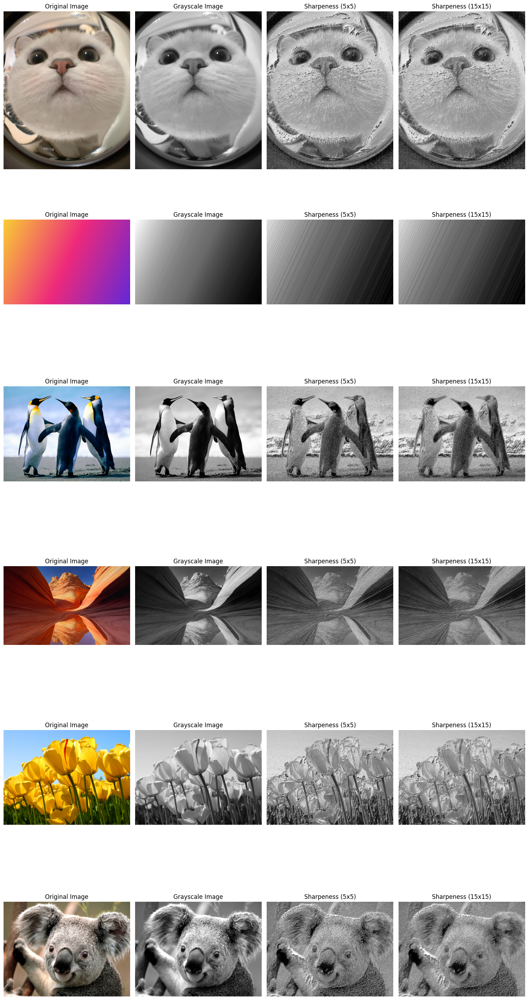

In [17]:
# ==============================
# Nomor 8
# ==============================
# Create a subplot for each image
fig, axes = plt.subplots(rows, cols, figsize=(15, 5 * rows))

# Loop through each image
for i, imgFilename in enumerate(images):
    # Read Image data
    oriImg = cv2.imread(imgFilename)

    # Display the original image
    axes[i, 0].imshow(cv2.cvtColor(oriImg, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis("off")

    # Read Image data
    img = cv2.imread(imgFilename, 0)

    # Define the kernels
    kernel1 = np.ones([5, 5], np.float32) / 25
    kernel2a = np.array([[1, 0, -1], [2, 0, -2], [1, 0, -1]])
    kernel2b = np.transpose(kernel2a)
    kernel2 = kernel2a + kernel2b

    # Apply the filters
    img_blur = cv2.filter2D(img, -1, kernel1)
    img_edge = 2 * cv2.filter2D(img, -1, kernel2)
    img_edge = np.uint8(img_edge)

    # Modified sharpening formula
    img_sharp = (img_blur + 2 * img_edge) / 3
    img_sharp = np.uint8(img_sharp)

    # Define the kernels for the second sharpening
    kernel1 = np.ones([15, 15], np.float32) / 225

    # Apply the filters for the second sharpening
    img_blur2 = cv2.filter2D(img, -1, kernel1)
    img_edge2 = 2 * cv2.filter2D(img, -1, kernel2)
    img_edge2 = np.uint8(img_edge2)

    # Modified sharpening formula for the second sharpening
    img_sharp2 = (img_blur2 + 2 * img_edge2) / 3
    img_sharp2 = np.uint8(img_sharp2)

    titles = [
        "Grayscale Image",
        "Sharpeness (5x5)",
        "Sharpeness (15x15)",
    ]

    brightnessImg = [img, img_sharp, img_sharp2]

    for j in range(len(titles)):
        # Display the image
        axes[i, j + 1].imshow(brightnessImg[j], cmap="gray")
        axes[i, j + 1].set_title(f"{titles[j]}")
        axes[i, j + 1].axis("off")

# Show the plot
plt.tight_layout()
plt.show()